# Installing Dependencies (CLIP, LPIPS)

In [1]:
!pip install -q timm ftfy regex tqdm opencv-python scikit-image
!pip install -q git+https://github.com/openai/CLIP.git
!pip install -q torchcam

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 1.6 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 363.4/363.4 MB 4.0 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 664.8/664.8 MB 1.7 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 211.5/211.5 MB 2.8 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 56.3/56.3 MB 29.7 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 127.9/127.9 MB 13.1 MB/s eta 0:00:00:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 207.5/207.5 MB 8.1 MB/s eta 0:00:000:00:0100:01
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.1/21.1 MB 84.1 MB/s eta 0:00:00:00:0100:01
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
pylibcugraph-cu12 24.12.0 requires pylibraft-cu12==24.12.*, but you have pylibraft-cu12 25.2.0 which is inc

In [2]:
!pip install lpips

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 53.8/53.8 kB 2.0 MB/s eta 0:00:00


# Loading pretrained models (ImageNet Dataset)

In [3]:
import torch
import torchvision.models as models

device = "cuda" if torch.cuda.is_available() else "cpu"

# Loading ResNet18 (using ResNet18 pretrained on ImageNet)
modelRN = models.resnet18(weights="IMAGENET1K_V1").eval().to(device)

# Loading EfficientNet Lite (using EfficientNet-B0 pretrained on ImageNet)
modelEN = models.efficientnet_b0(weights=models.EfficientNet_B0_Weights.IMAGENET1K_V1).eval().to(device)

Downloading: "https://download.pytorch.org/models/resnet18-f37072fd.pth" to /root/.cache/torch/hub/checkpoints/resnet18-f37072fd.pth
100%|██████████| 44.7M/44.7M [00:00<00:00, 154MB/s] 
Downloading: "https://download.pytorch.org/models/efficientnet_b0_rwightman-7f5810bc.pth" to /root/.cache/torch/hub/checkpoints/efficientnet_b0_rwightman-7f5810bc.pth
100%|██████████| 20.5M/20.5M [00:00<00:00, 140MB/s] 


# Creating Subset of ImageNet-256 Dataset for both ResNet18 and EfficientNet-B0 Models and Loading the OOD Dataset

In [4]:
# Importing Libraries
import os
import torch
import torchvision.transforms as T
from torchvision import datasets, models
from torch.utils.data import DataLoader
from PIL import Image
from torch.utils.data import Subset
import numpy as np
import clip
import cv2
from torchvision import datasets
from collections import defaultdict
import matplotlib.pyplot as plt
from skimage.segmentation import slic
from torchcam.methods import GradCAM
from torchcam.utils import overlay_mask

# Loading the model (CLIP model (Vit B/32))
device = "cuda" if torch.cuda.is_available() else "cpu"
clipModel, clipPreprocess = clip.load("ViT-B/32", device=device)

# Dataset path
imagenetRoot = "/kaggle/input/imagenet-256"

# Defining the transforms
transform = T.Compose([
    T.Resize((224, 224)),
    T.ToTensor(),
    T.Normalize(mean=[0.485, 0.456, 0.406],
                std=[0.229, 0.224, 0.225]),
])

rawTransform = T.Resize((224, 224))  # Only resizing, no tensor/norm

# Loading raw dataset with no transforms
fullDataset = datasets.ImageFolder(root=imagenetRoot)

# Selecting 10 samples per class as this is just the testing set
classCounts = defaultdict(int)
selectedIndices = []

for idx, (path, label) in enumerate(fullDataset.imgs):
    if classCounts[label] < 10:
        selectedIndices.append(idx)
        classCounts[label] += 1

# Creating subset of the dataset
subsetDataset = Subset(fullDataset, selectedIndices)

# Defining a wrapper to apply transforms later
class TransformWrapper(torch.utils.data.Dataset):
    def __init__(self, subset, transform=None):
        self.subset = subset
        self.transform = transform

    def __getitem__(self, idx):
        img, label = self.subset[idx]  # img is already a PIL Image
        if self.transform:
            img = self.transform(img)
        return img, label

    def __len__(self):
        return len(self.subset)

# Creating two datasets: one with transform, one raw
imagenetDataset = TransformWrapper(subsetDataset, transform=transform)
rawDataset = TransformWrapper(subsetDataset, transform=rawTransform)

imgTensor, label = imagenetDataset[0]
pilImage, _ = rawDataset[0]
inputTensor = imgTensor.unsqueeze(0).to(device)

from torchvision import datasets

# Loading OOD dataset (DTD)
oodDataset = datasets.DTD(root='/kaggle/working', download=True, transform=clipPreprocess)
oodLoader = DataLoader(oodDataset, batch_size=64, shuffle=True)

100%|████████████████████████████████████████| 338M/338M [00:03<00:00, 101MiB/s]


100%|██████████| 625M/625M [00:23<00:00, 27.0MB/s] 


Extracting /kaggle/working/dtd/dtd-r1.0.1.tar.gz to /kaggle/working/dtd


# Creating Subverted Images with ResNet18 Causal Regions

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)
Downloading: "https://download.pytorch.org/models/alexnet-owt-7be5be79.pth" to /root/.cache/torch/hub/checkpoints/alexnet-owt-7be5be79.pth
100%|██████████| 233M/233M [00:01<00:00, 206MB/s] 
/usr/local/lib/python3.11/dist-packages/lpips/lpips.py:107: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle mo

Loading model from: /usr/local/lib/python3.11/dist-packages/lpips/weights/v0.1/alex.pth
[0] Original Class: 398, Conf: 1.0000 | Subverted Class: 398, Conf: 0.9957


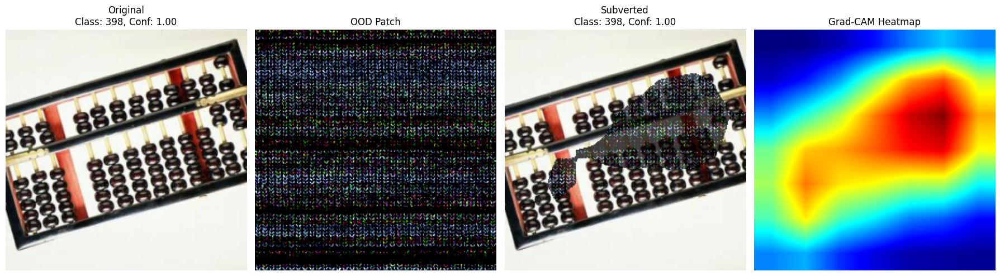

[10] Original Class: 399, Conf: 0.8856 | Subverted Class: 399, Conf: 0.1650


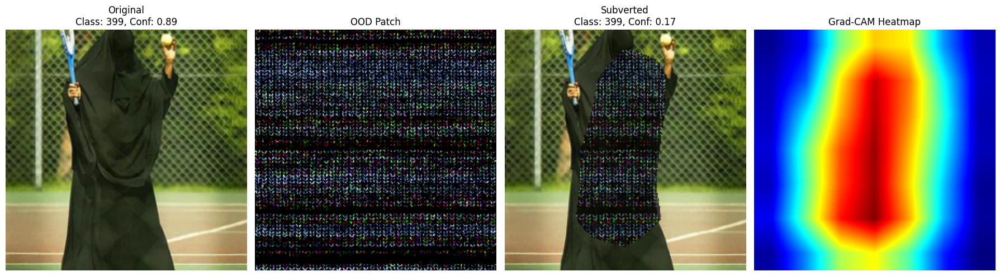

[20] Original Class: 400, Conf: 0.8861 | Subverted Class: 887, Conf: 0.1357


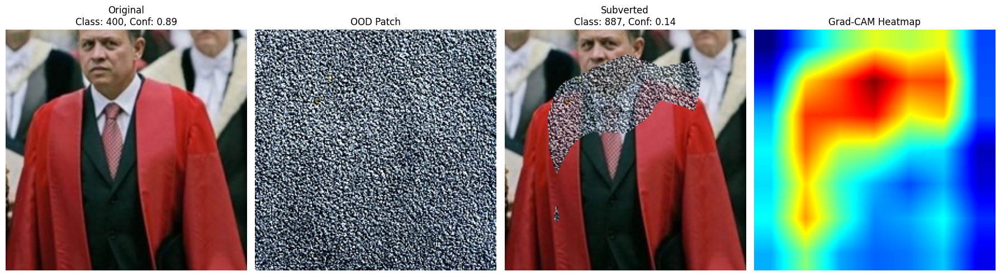

[30] Original Class: 401, Conf: 0.9599 | Subverted Class: 401, Conf: 0.6677


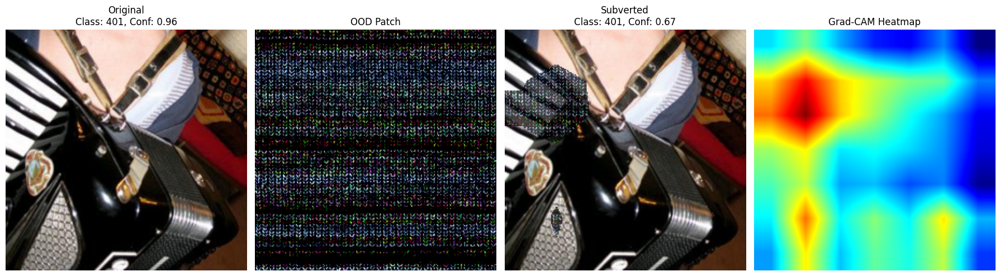

[40] Original Class: 988, Conf: 0.6213 | Subverted Class: 995, Conf: 0.2322


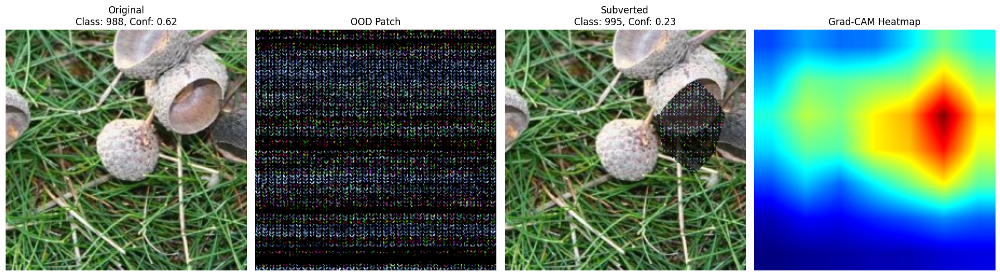

[50] Original Class: 941, Conf: 0.9410 | Subverted Class: 941, Conf: 0.8690


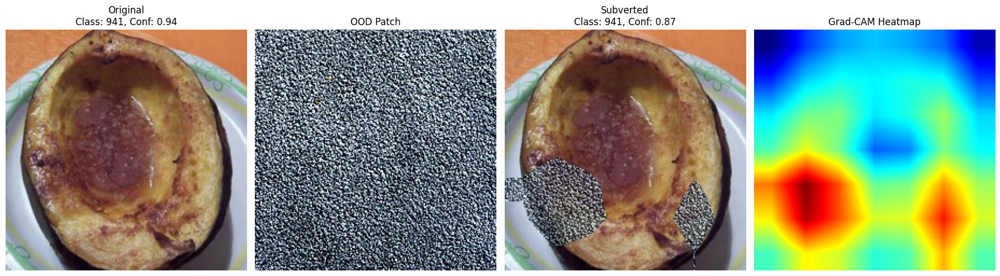

In [5]:
import torch
import numpy as np
import cv2
import matplotlib.pyplot as plt
from PIL import Image
from torchvision import transforms as T, models
from torchcam.methods import GradCAM
import torch.nn.functional as F
import lpips
import clip

# Loading LPIPS model (alex)
lpipsModel = lpips.LPIPS(net='alex').to(device)

# Unnormalization for visualizing better
unnormalize = T.Normalize(
    mean=[-0.485 / 0.229, -0.456 / 0.224, -0.406 / 0.225],
    std=[1 / 0.229, 1 / 0.224, 1 / 0.225]
)

# Transform function for LPIPS
transformLpips = T.Compose([
    T.Resize((224, 224)),
    T.ToTensor(),
])

# For blended tensor
transformModel = T.Compose([
    T.ToTensor(),
    T.Normalize(mean=[0.485, 0.456, 0.406],
                std=[0.229, 0.224, 0.225]),
])

# Setting up Grad-CAM for ResNet18 Model
target_layer = modelRN.layer4[-1]
camExtractor = GradCAM(modelRN, target_layer)

# Main loop
for idx in range(60):  # Iterating through images in the subset (I am just taking 60 for faster computation)
    imgTensor, label = imagenetDataset[idx]
    inputTensor = imgTensor.unsqueeze(0).to(device)

    # First we unnormalize it and then we convert it to PIL
    pilImage = T.ToPILImage()(unnormalize(imgTensor).clamp(0, 1)).convert('RGB')
    origImgNp = np.array(pilImage.resize((224, 224)))

    # Predicting the class and then extracting attention maps with gradCAM
    output = modelRN(inputTensor)
    probs = F.softmax(output, dim=1)
    predClass = probs.argmax(dim=1).item()
    activationMap = camExtractor(predClass, output)[0].mean(dim=0).cpu().numpy()
    camUint8 = (cv2.resize(activationMap, (224, 224)) * 255).astype(np.uint8)
    camRgb = cv2.applyColorMap(camUint8, cv2.COLORMAP_JET)
    camRgb = cv2.cvtColor(camRgb, cv2.COLOR_BGR2RGB)
    camRgbPil = Image.fromarray(camRgb).convert('RGB')

    # Extracting Feature Vectors
    imageClip = clipPreprocess(pilImage).unsqueeze(0).to(device)
    imageFeatures = clipModel.encode_image(imageClip).detach()
    origTensor = transformLpips(pilImage).unsqueeze(0).to(device)
    origLpipsTensor = (origTensor * 2) - 1  # LPIPS expects [-1, 1]

    # Searching for the most dissimilar OOD image in the dataset
    maxtotDist = -float("inf")
    bestPatch = None
    
    # Looping over the OOD dataset
    for batch, _ in oodLoader:
        batch = batch.to(device)
        
        # Looping over each image in the batch
        for i in range(batch.size(0)):
            patch = batch[i].unsqueeze(0)
    
            # Preparing patch for LPIPS by resizing and scaling
            patchResized = T.functional.resize(patch, [224, 224])
            patchLpips = (patchResized * 2) - 1
            textureDiff = lpipsModel(origLpipsTensor, patchLpips).item()
    
            # Preparing patch for CLIP by preprocessing and encoding
            patchpil = T.ToPILImage()(patchResized.squeeze(0).cpu())
            patchClip = clipPreprocess(patchpil).unsqueeze(0).to(device)
            patchFeatures = clipModel.encode_image(patchClip).detach()
            clipDist = 1 - F.cosine_similarity(imageFeatures, patchFeatures).item()
    
            # Combining LPIPS and CLIP distances
            totscore = textureDiff + clipDist
    
            # Updating best patch if the current total score is the highest
            if totscore > maxtotDist:
                maxtotDist = totscore
                bestPatch = patchResized.squeeze(0)

    if bestPatch is None:
        continue

    oodImgNp = (bestPatch.permute(1, 2, 0).cpu().numpy() * 255).clip(0, 255).astype(np.uint8)

    # Creating a GradCAM mask with Red and Orange regions (most influential)
    # Specifying the ranges for the color from Dark Red (most influential) to orange
    orangeLow = np.array([180, 60, 0])
    orangeHigh = np.array([255, 180, 100])
    orangeMask = cv2.inRange(camRgb, orangeLow, orangeHigh)

    lowerRed = np.array([200, 0, 0])
    upperRed = np.array([255, 60, 60])
    brightRedMask = cv2.inRange(camRgb, lowerRed, upperRed)

    LowDred = np.array([120, 0, 0])
    HighDred = np.array([200, 40, 40])
    DredMask = cv2.inRange(camRgb, LowDred, HighDred)

    # Combining Red and Orange mask
    combMask = cv2.bitwise_or(orangeMask, brightRedMask)
    combMask = cv2.bitwise_or(combMask, DredMask)
    combMask_3ch = np.stack([combMask] * 3, axis=-1) // 255
    inv_mask = 1 - combMask_3ch

    # Blending the patch with ID image
    alpha = 0.75
    blendedReg = (alpha * oodImgNp + (1 - alpha) * origImgNp).astype(np.uint8)
    subvertedImg = (blendedReg * combMask_3ch + origImgNp * inv_mask).astype(np.uint8)

    # Then we use the transform for the model and predict the class
    blendedTensor = transformModel(Image.fromarray(subvertedImg)).unsqueeze(0).to(device)

    # Output of original image
    orgOutput = modelRN(inputTensor)
    orgProbs = F.softmax(orgOutput, dim=1)
    orgPred = orgProbs.argmax(dim=1).item()
    orgConf = orgProbs[0, orgPred].item()

    # Output of attacked image
    attackedOutput = modelRN(blendedTensor)
    attackedProbs = F.softmax(attackedOutput, dim=1)
    attackedPred = attackedProbs.argmax(dim=1).item()
    attackedConf = attackedProbs[0, attackedPred].item()

    # Visualizing every 10th Image
    if idx % 10 == 0:
        print(f"[{idx}] Original Class: {orgPred}, Conf: {orgConf:.4f} | Subverted Class: {attackedPred}, Conf: {attackedConf:.4f}")
        plt.figure(figsize=(18, 6))

        plt.subplot(1, 4, 1)
        plt.imshow(origImgNp)
        plt.title(f"Original\nClass: {orgPred}, Conf: {orgConf:.2f}")
        plt.axis("off")

        plt.subplot(1, 4, 2)
        plt.imshow(oodImgNp)
        plt.title("OOD Patch")
        plt.axis("off")

        plt.subplot(1, 4, 3)
        plt.imshow(subvertedImg)
        plt.title(f"Subverted\nClass: {attackedPred}, Conf: {attackedConf:.2f}")
        plt.axis("off")

        plt.subplot(1, 4, 4)
        plt.imshow(camRgbPil)
        plt.title("Grad-CAM Heatmap")
        plt.axis("off")

        plt.tight_layout()
        plt.show()

# Creating Subverted Images with EfficientNet-B0 Causal Regions

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: /usr/local/lib/python3.11/dist-packages/lpips/weights/v0.1/alex.pth
[0] Original Class: 398, Conf: 0.9699 | Subverted Class: 398, Conf: 0.9683


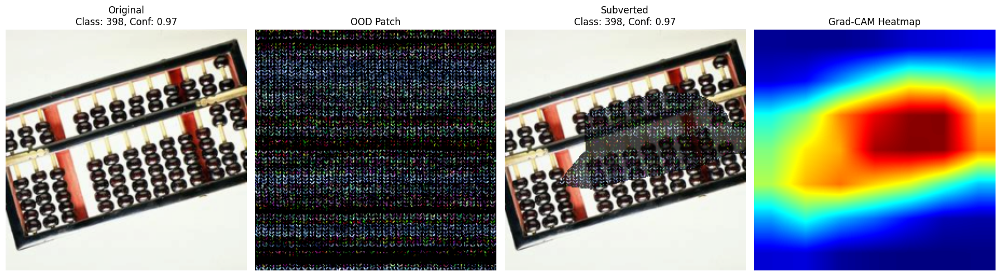

[10] Original Class: 399, Conf: 0.9279 | Subverted Class: 752, Conf: 0.4534


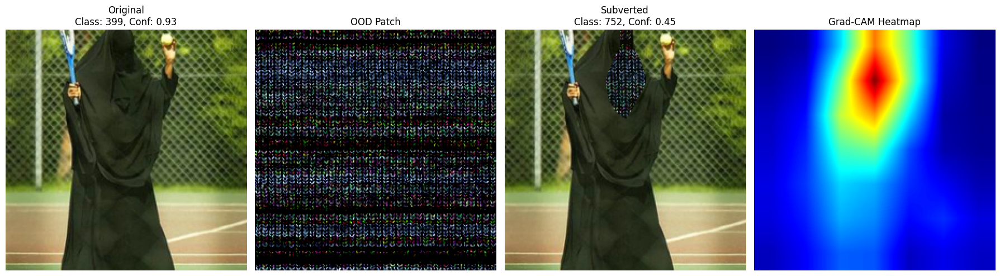

[20] Original Class: 400, Conf: 0.6300 | Subverted Class: 400, Conf: 0.1163


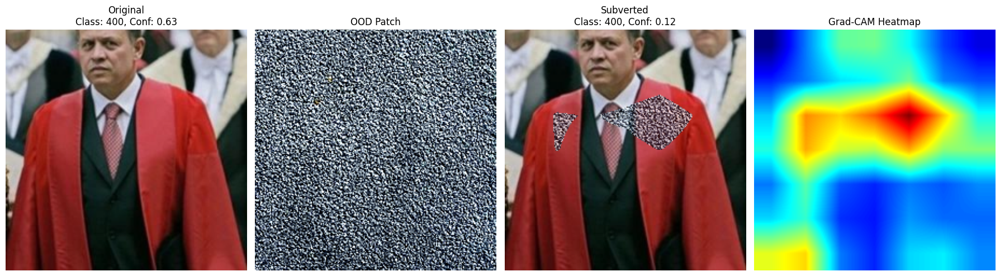

[30] Original Class: 401, Conf: 0.8156 | Subverted Class: 401, Conf: 0.4253


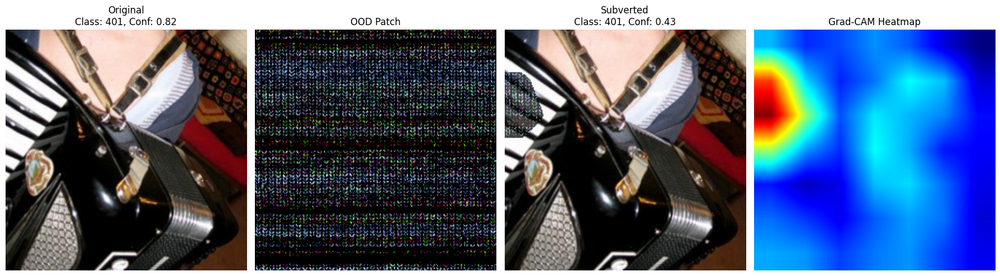

[40] Original Class: 988, Conf: 0.2837 | Subverted Class: 996, Conf: 0.2794


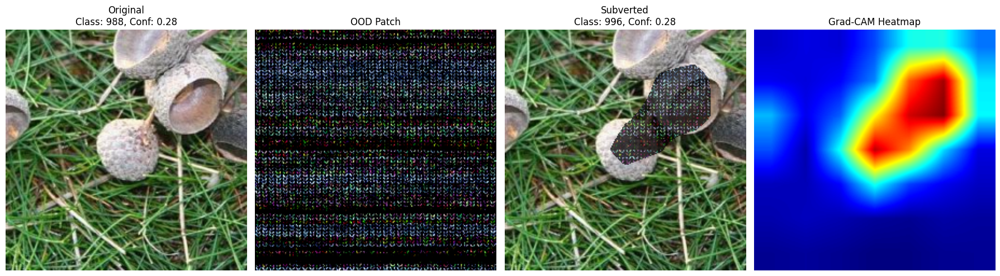

[50] Original Class: 941, Conf: 0.6950 | Subverted Class: 941, Conf: 0.4834


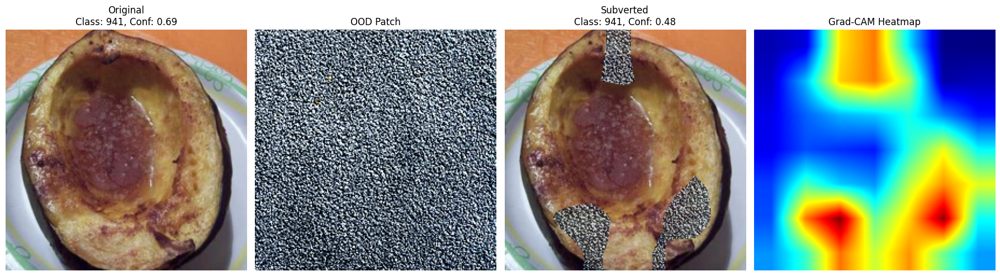

In [6]:
import torch
import numpy as np
import cv2
import matplotlib.pyplot as plt
from PIL import Image
from torchvision import transforms as T, models
from torchcam.methods import GradCAM
import torch.nn.functional as F
import lpips
import clip

# Loading LPIPS model (alex)
lpipsModel = lpips.LPIPS(net='alex').to(device)

# Unnormalization for visualizing better
unnormalize = T.Normalize(
    mean=[-0.485 / 0.229, -0.456 / 0.224, -0.406 / 0.225],
    std=[1 / 0.229, 1 / 0.224, 1 / 0.225]
)

# Transform function for LPIPS
transformLpips = T.Compose([
    T.Resize((224, 224)),
    T.ToTensor(),
])

# For blended tensor
transformModel = T.Compose([
    T.ToTensor(),
    T.Normalize(mean=[0.485, 0.456, 0.406],
                std=[0.229, 0.224, 0.225]),
])

# Setting up Grad-CAM for EfficientNet-B0 Model
target_layer = modelEN.features[-1]
camExtractor = GradCAM(modelEN, target_layer)

# Main loop
for idx in range(60):  # Iterating through images in the subset
    imgTensor, label = imagenetDataset[idx]
    inputTensor = imgTensor.unsqueeze(0).to(device)

    # First we unnormalize it and then we convert it to PIL
    pilImage = T.ToPILImage()(unnormalize(imgTensor).clamp(0, 1)).convert('RGB')
    origImgNp = np.array(pilImage.resize((224, 224)))

    # Predicting the class and then extracting attention maps with gradCAM
    output = modelEN(inputTensor)
    probs = F.softmax(output, dim=1)
    predClass = probs.argmax(dim=1).item()
    activationMap = camExtractor(predClass, output)[0].mean(dim=0).cpu().numpy()
    camUint8 = (cv2.resize(activationMap, (224, 224)) * 255).astype(np.uint8)
    camRgb = cv2.applyColorMap(camUint8, cv2.COLORMAP_JET)
    camRgb = cv2.cvtColor(camRgb, cv2.COLOR_BGR2RGB)
    camRgbPil = Image.fromarray(camRgb).convert('RGB')

    # Extracting Feature Vectors
    imageClip = clipPreprocess(pilImage).unsqueeze(0).to(device)
    imageFeatures = clipModel.encode_image(imageClip).detach()
    origTensor = transformLpips(pilImage).unsqueeze(0).to(device)
    origLpipsTensor = (origTensor * 2) - 1  # LPIPS expects [-1, 1]

    # Searching for the most dissimilar OOD image in the dataset
    maxtotDist = -float("inf")
    bestPatch = None
    
    # Looping over the OOD dataset
    for batch, _ in oodLoader:
        batch = batch.to(device)
        
        # Looping over each image in the batch
        for i in range(batch.size(0)):
            patch = batch[i].unsqueeze(0)
    
            # Preparing patch for LPIPS by resizing and scaling
            patchResized = T.functional.resize(patch, [224, 224])
            patchLpips = (patchResized * 2) - 1
            textureDiff = lpipsModel(origLpipsTensor, patchLpips).item()
    
            # Preparing patch for CLIP by preprocessing and encoding
            patchpil = T.ToPILImage()(patchResized.squeeze(0).cpu())
            patchClip = clipPreprocess(patchpil).unsqueeze(0).to(device)
            patchFeatures = clipModel.encode_image(patchClip).detach()
            clipDist = 1 - F.cosine_similarity(imageFeatures, patchFeatures).item()
    
            # Combining LPIPS and CLIP distances
            totscore = textureDiff + clipDist
    
            # Updating best patch if the current total score is the highest
            if totscore > maxtotDist:
                maxtotDist = totscore
                bestPatch = patchResized.squeeze(0)

    if bestPatch is None:
        continue

    oodImgNp = (bestPatch.permute(1, 2, 0).cpu().numpy() * 255).clip(0, 255).astype(np.uint8)

    # Creating a GradCAM mask with Red and Orange regions (most influential)
    # Specifying the ranges for the color from Dark Red (most influential) to orange
    orangeLow = np.array([180, 60, 0])
    orangeHigh = np.array([255, 180, 100])
    orangeMask = cv2.inRange(camRgb, orangeLow, orangeHigh)

    lowerRed = np.array([200, 0, 0])
    upperRed = np.array([255, 60, 60])
    brightRedMask = cv2.inRange(camRgb, lowerRed, upperRed)

    LowDred = np.array([120, 0, 0])
    HighDred = np.array([200, 40, 40])
    DredMask = cv2.inRange(camRgb, LowDred, HighDred)

    # Combining Red and Orange mask
    combMask = cv2.bitwise_or(orangeMask, brightRedMask)
    combMask = cv2.bitwise_or(combMask, DredMask)
    combMask_3ch = np.stack([combMask] * 3, axis=-1) // 255
    inv_mask = 1 - combMask_3ch

    # Blending the patch with ID image
    alpha = 0.75
    blendedReg = (alpha * oodImgNp + (1 - alpha) * origImgNp).astype(np.uint8)
    subvertedImg = (blendedReg * combMask_3ch + origImgNp * inv_mask).astype(np.uint8)

    # Then we use the transform for the model and predict the class
    blendedTensor = transformModel(Image.fromarray(subvertedImg)).unsqueeze(0).to(device)

    # Output of original image
    orgOutput = modelEN(inputTensor)
    orgProbs = F.softmax(orgOutput, dim=1)
    orgPred = orgProbs.argmax(dim=1).item()
    orgConf = orgProbs[0, orgPred].item()

    # Output of attacked image
    attackedOutput = modelEN(blendedTensor)
    attackedProbs = F.softmax(attackedOutput, dim=1)
    attackedPred = attackedProbs.argmax(dim=1).item()
    attackedConf = attackedProbs[0, attackedPred].item()

    # Visualizing every 10th Image
    if idx % 10 == 0:
        print(f"[{idx}] Original Class: {orgPred}, Conf: {orgConf:.4f} | Subverted Class: {attackedPred}, Conf: {attackedConf:.4f}")
        plt.figure(figsize=(18, 6))

        plt.subplot(1, 4, 1)
        plt.imshow(origImgNp)
        plt.title(f"Original\nClass: {orgPred}, Conf: {orgConf:.2f}")
        plt.axis("off")

        plt.subplot(1, 4, 2)
        plt.imshow(oodImgNp)
        plt.title("OOD Patch")
        plt.axis("off")

        plt.subplot(1, 4, 3)
        plt.imshow(subvertedImg)
        plt.title(f"Subverted\nClass: {attackedPred}, Conf: {attackedConf:.2f}")
        plt.axis("off")

        plt.subplot(1, 4, 4)
        plt.imshow(camRgbPil)
        plt.title("Grad-CAM Heatmap")
        plt.axis("off")

        plt.tight_layout()
        plt.show()

# Loading Saved Models for Intel Classification Dataset

In [7]:
from torchvision import models

# Loading my custom-trained ResNet-18 model with 6 output classes
modelRNI = models.resnet18(pretrained=False, num_classes=6)
modelRNI.load_state_dict(torch.load("/kaggle/input/intel_resnet/pytorch/default/1/resnet18_best.pth"))
modelRNI = modelRNI.to(device)
modelRNI.eval()

import torchvision.models as models
import torch.nn as nn

# Loading EfficientNet Lite (using EfficientNet-B0 pretrained on ImageNet)
modelENI = models.efficientnet_b0(weights=None)  # No pretrained weights
modelENI.classifier[1] = nn.Linear(modelENI.classifier[1].in_features, 7)

# Loading trained weights
modelENI.load_state_dict(torch.load("/kaggle/input/efficientnet_intel/pytorch/default/1/best_model.pth"))

# Moving to device
modelENI = modelENI.to(device)
modelENI.eval()

/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=None`.
  warnings.warn(msg)
/tmp/ipykernel_31/228379754.py:5: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend

EfficientNet(
  (features): Sequential(
    (0): Conv2dNormActivation(
      (0): Conv2d(3, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1), bias=False)
      (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
      (2): SiLU(inplace=True)
    )
    (1): Sequential(
      (0): MBConv(
        (block): Sequential(
          (0): Conv2dNormActivation(
            (0): Conv2d(32, 32, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1), groups=32, bias=False)
            (1): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
            (2): SiLU(inplace=True)
          )
          (1): SqueezeExcitation(
            (avgpool): AdaptiveAvgPool2d(output_size=1)
            (fc1): Conv2d(32, 8, kernel_size=(1, 1), stride=(1, 1))
            (fc2): Conv2d(8, 32, kernel_size=(1, 1), stride=(1, 1))
            (activation): SiLU(inplace=True)
            (scale_activation): Sigmoid()
          )
          (2): Conv2dNormActivat

# Testing on Intel Classification Dataset for both ResNet18 and EfficientNet-B0 Models

In [8]:
# Importing all necessary libraries for dataset handling, model loading, preprocessing, and visualization
import os
import torch
import torchvision.transforms as T
from torchvision import datasets, models
from torch.utils.data import DataLoader, Subset
from PIL import Image
import numpy as np
import clip
import cv2
from collections import defaultdict
import matplotlib.pyplot as plt
from skimage.segmentation import slic
from torchcam.methods import GradCAM
from torchcam.utils import overlay_mask

# Loading the CLIP model (ViT-B/32) for later comparison tasks
clipModel, clipPreprocess = clip.load("ViT-B/32", device=device)

# Pointing to the Intel Image Dataset location
intel_root = "/kaggle/input/intel-image-dataset/Intel Image Dataset"

# Defining the standard transform for model inputs (resizing, tensor conversion, and normalization)
transform = T.Compose([
    T.Resize((224, 224)),
    T.ToTensor(),
    T.Normalize(mean=[0.485, 0.456, 0.406], std=[0.229, 0.224, 0.225]),
])

# Defining a simple resizing transform for keeping raw PIL images
rawTransform = T.Resize((224, 224))

# Loading the full dataset without applying any transform yet
fullDataset = datasets.ImageFolder(root=intel_root)

# Selecting 10 samples per class by tracking counts
classCounts = defaultdict(int)
selectedIndices = []

for idx, (path, label) in enumerate(fullDataset.imgs):
    if classCounts[label] < 10:
        selectedIndices.append(idx)
        classCounts[label] += 1

# Creating a subset using only the selected indices
subsetDataset = Subset(fullDataset, selectedIndices)

# Wrapping the subset with a custom Dataset class for applying transforms on the fly
class TransformWrapper(torch.utils.data.Dataset):
    def __init__(self, subset, transform=None):
        self.subset = subset
        self.transform = transform

    def __getitem__(self, idx):
        img, label = self.subset[idx]  # Getting raw PIL image
        if self.transform:
            img = self.transform(img)
        return img, label

    def __len__(self):
        return len(self.subset)

# Creating a transformed dataset for model input and raw dataset
intel_dataset = TransformWrapper(subsetDataset, transform=transform)
rawDataset = TransformWrapper(subsetDataset, transform=rawTransform)

imgTensor, label = intel_dataset[0]
pilImage, _ = rawDataset[0]
inputTensor = imgTensor.unsqueeze(0).to(device)

from torchvision import datasets

# Loading OOD dataset (DTD)
oodDataset = datasets.DTD(root='/kaggle/working', download=True, transform=clipPreprocess)
oodLoader = DataLoader(oodDataset, batch_size=64, shuffle=True)

# Creating Subverted Images with ResNet18 Causal Regions

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: /usr/local/lib/python3.11/dist-packages/lpips/weights/v0.1/alex.pth
[0] Original Class: 0, Conf: 1.0000 | Subverted Class: 0, Conf: 0.9999


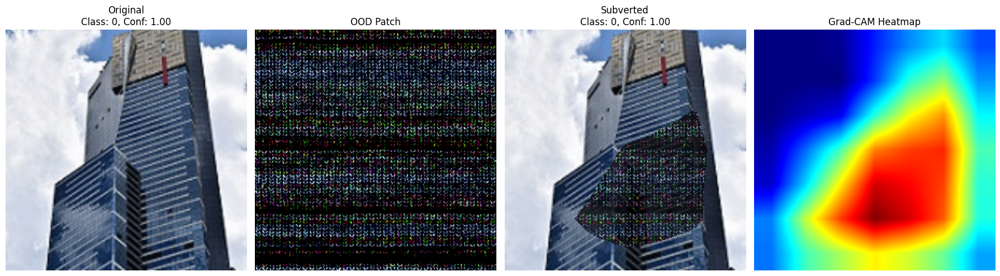

[10] Original Class: 1, Conf: 0.9975 | Subverted Class: 5, Conf: 0.5231


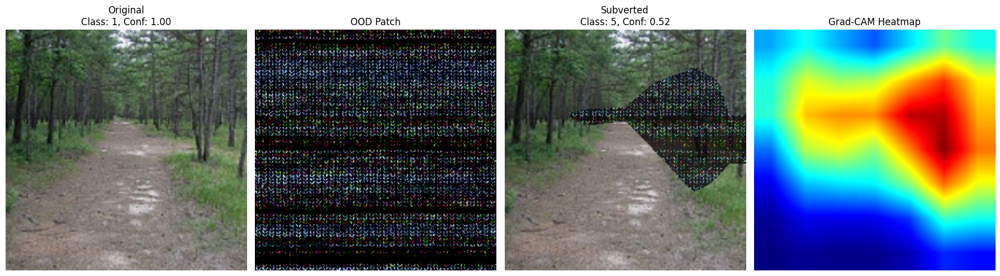

[20] Original Class: 2, Conf: 1.0000 | Subverted Class: 0, Conf: 0.6985


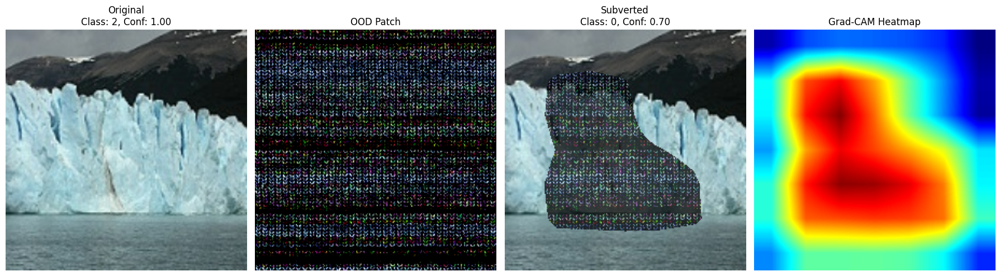

[30] Original Class: 3, Conf: 0.9218 | Subverted Class: 4, Conf: 0.4652


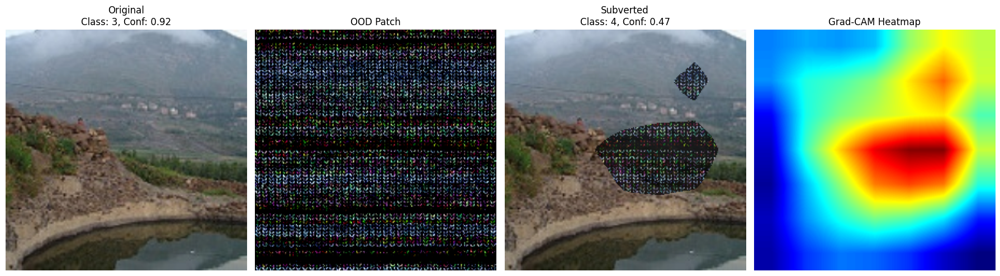

[40] Original Class: 4, Conf: 0.9984 | Subverted Class: 4, Conf: 0.8981


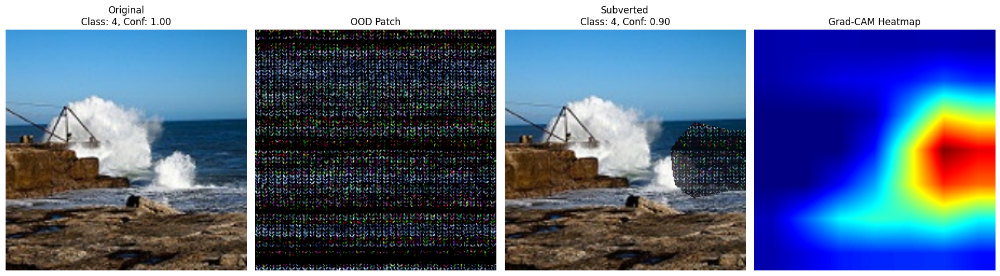

In [9]:
# Importing libraries for model, vision, similarity, and visualization
import torch
import numpy as np
import cv2
import matplotlib.pyplot as plt
from PIL import Image
from torchvision import transforms as T, models
from torchcam.methods import GradCAM
import torch.nn.functional as F
import lpips
import clip

# Loading CLIP model and LPIPS for perceptual similarity
clipModel, clipPreprocess = clip.load("ViT-B/32", device=device)
lpipsModel = lpips.LPIPS(net='alex').to(device)

# Setting up normalization to reverse ImageNet preprocessing
unnormalize = T.Normalize(
    mean=[-0.485 / 0.229, -0.456 / 0.224, -0.406 / 0.225],
    std=[1 / 0.229, 1 / 0.224, 1 / 0.225]
)

# Defining transforms for LPIPS and model inputs
transformLpips = T.Compose([
    T.Resize((224, 224)),
    T.ToTensor(),
])

transformModel = T.Compose([
    T.ToTensor(),
    T.Normalize(mean=[0.485, 0.456, 0.406],
                std=[0.229, 0.224, 0.225]),
])

# Setting up GradCAM to extract attention from the last layer
target_layer = modelRNI.layer4[-1]
camExtractor = GradCAM(modelRNI, target_layer)

# Processing multiple images from the dataset
for idx in range(50):
    imgTensor, label = intel_dataset[idx]
    inputTensor = imgTensor.unsqueeze(0).to(device)

    # Unnormalizing and converting tensor to PIL image
    pilImage = T.ToPILImage()(unnormalize(imgTensor).clamp(0, 1)).convert('RGB')
    origImgNp = np.array(pilImage.resize((224, 224)))

    # Running forward pass to get predictions
    output = modelRNI(inputTensor)
    probs = F.softmax(output, dim=1)
    predClass = probs.argmax(dim=1).item()

    # Generating Grad-CAM heatmap for the predicted class
    activationMap = camExtractor(predClass, output)[0].mean(dim=0).cpu().numpy()
    camUint8 = (cv2.resize(activationMap, (224, 224)) * 255).astype(np.uint8)
    camRgb = cv2.applyColorMap(camUint8, cv2.COLORMAP_JET)
    camRgb = cv2.cvtColor(camRgb, cv2.COLOR_BGR2RGB)
    camRgbPil = Image.fromarray(camRgb).convert('RGB')

    # Extracting CLIP and LPIPS features for original image
    imageClip = clipPreprocess(pilImage).unsqueeze(0).to(device)
    imageFeatures = clipModel.encode_image(imageClip).detach()
    origTensor = transformLpips(pilImage).unsqueeze(0).to(device)
    origLpipsTensor = (origTensor * 2) - 1

    # Searching for an OOD patch that looks different both visually and semantically
    maxtotDist = -float("inf")
    bestPatch = None
    for batch, _ in oodLoader:
        batch = batch.to(device)
        for i in range(batch.size(0)):
            patch = batch[i].unsqueeze(0)
            patchResized = T.functional.resize(patch, [224, 224])
            patchLpips = (patchResized * 2) - 1
            textureDiff = lpipsModel(origLpipsTensor, patchLpips).item()

            # Calculating CLIP feature distance
            patchpil = T.ToPILImage()(patchResized.squeeze(0).cpu())
            patchClip = clipPreprocess(patchpil).unsqueeze(0).to(device)
            patchFeatures = clipModel.encode_image(patchClip).detach()
            clipDist = 1 - F.cosine_similarity(imageFeatures, patchFeatures).item()

            # Combining texture and semantic difference
            totscore = textureDiff + clipDist
            if totscore > maxtotDist:
                maxtotDist = totscore
                bestPatch = patchResized.squeeze(0)

    # Skipping if no patch was found
    if bestPatch is None:
        continue

    # Preparing selected OOD patch for blending
    oodImgNp = (bestPatch.permute(1, 2, 0).cpu().numpy() * 255).clip(0, 255).astype(np.uint8)

    # Creating masks for important causal regions from Grad-CAM
    orangeLow = np.array([180, 60, 0])
    orangeHigh = np.array([255, 180, 100])
    orangeMask = cv2.inRange(camRgb, orangeLow, orangeHigh)

    lowerRed = np.array([200, 0, 0])
    upperRed = np.array([255, 60, 60])
    brightRedMask = cv2.inRange(camRgb, lowerRed, upperRed)

    LowDred = np.array([120, 0, 0])
    HighDred = np.array([200, 40, 40])
    DredMask = cv2.inRange(camRgb, LowDred, HighDred)

    # Merging all critical region masks
    combMask = cv2.bitwise_or(orangeMask, brightRedMask)
    combMask = cv2.bitwise_or(combMask, DredMask)
    combMask_3ch = np.stack([combMask] * 3, axis=-1) // 255
    inv_mask = 1 - combMask_3ch

    # Blending OOD patch into the critical regions of the original image
    alpha = 0.75
    blendedReg = (alpha * oodImgNp + (1 - alpha) * origImgNp).astype(np.uint8)
    subvertedImg = (blendedReg * combMask_3ch + origImgNp * inv_mask).astype(np.uint8)

    # Classifying original and subverted images
    blendedTensor = transformModel(Image.fromarray(subvertedImg)).unsqueeze(0).to(device)

    orgOutput = modelRNI(inputTensor)
    orgProbs = F.softmax(orgOutput, dim=1)
    orgPred = orgProbs.argmax(dim=1).item()
    orgConf = orgProbs[0, orgPred].item()

    attackedOutput = modelRNI(blendedTensor)
    attackedProbs = F.softmax(attackedOutput, dim=1)
    attackedPred = attackedProbs.argmax(dim=1).item()
    attackedConf = attackedProbs[0, attackedPred].item()

    # Visualizing every 10th attack result
    if idx % 10 == 0:
        print(f"[{idx}] Original Class: {orgPred}, Conf: {orgConf:.4f} | Subverted Class: {attackedPred}, Conf: {attackedConf:.4f}")
        plt.figure(figsize=(18, 6))

        plt.subplot(1, 4, 1)
        plt.imshow(origImgNp)
        plt.title(f"Original\nClass: {orgPred}, Conf: {orgConf:.2f}")
        plt.axis("off")

        plt.subplot(1, 4, 2)
        plt.imshow(oodImgNp)
        plt.title("OOD Patch")
        plt.axis("off")

        plt.subplot(1, 4, 3)
        plt.imshow(subvertedImg)
        plt.title(f"Subverted\nClass: {attackedPred}, Conf: {attackedConf:.2f}")
        plt.axis("off")

        plt.subplot(1, 4, 4)
        plt.imshow(camRgbPil)
        plt.title("Grad-CAM Heatmap")
        plt.axis("off")

        plt.tight_layout()
        plt.show()


# Creating Subverted Images with EfficientNet-B0 Causal Regions

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]
Loading model from: /usr/local/lib/python3.11/dist-packages/lpips/weights/v0.1/alex.pth
[0] Original Class: 0, Conf: 0.9996 | Subverted Class: 0, Conf: 0.9992


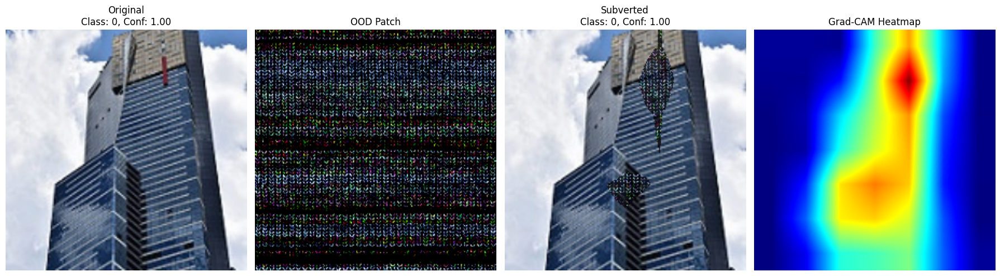

[10] Original Class: 1, Conf: 1.0000 | Subverted Class: 1, Conf: 1.0000


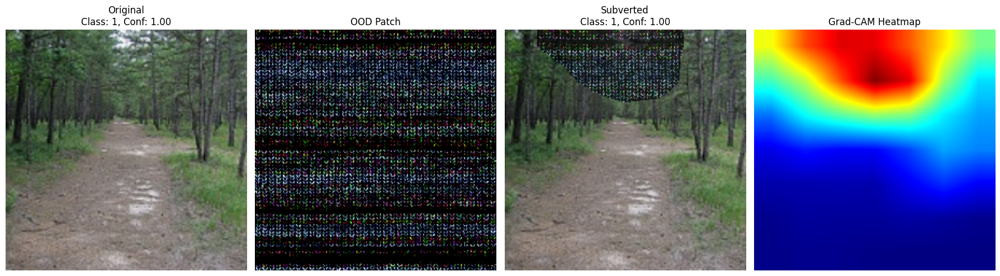

[20] Original Class: 2, Conf: 0.9999 | Subverted Class: 2, Conf: 0.9964


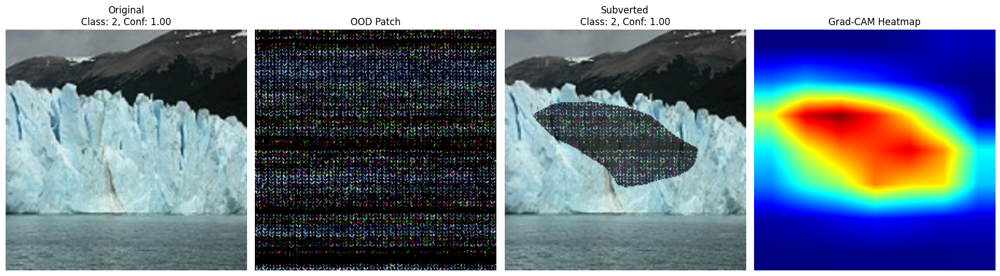

[30] Original Class: 3, Conf: 0.9990 | Subverted Class: 4, Conf: 0.4461


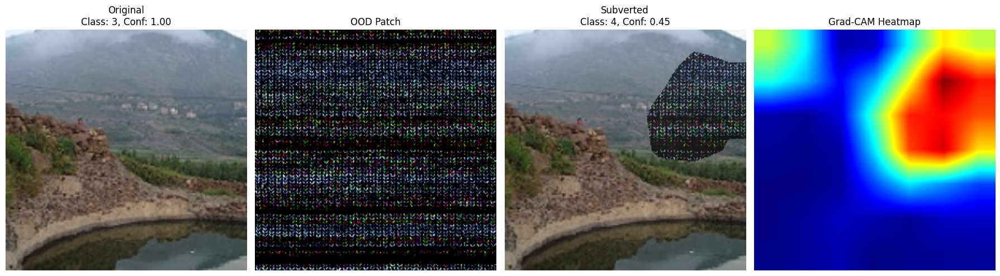

[40] Original Class: 4, Conf: 1.0000 | Subverted Class: 4, Conf: 1.0000


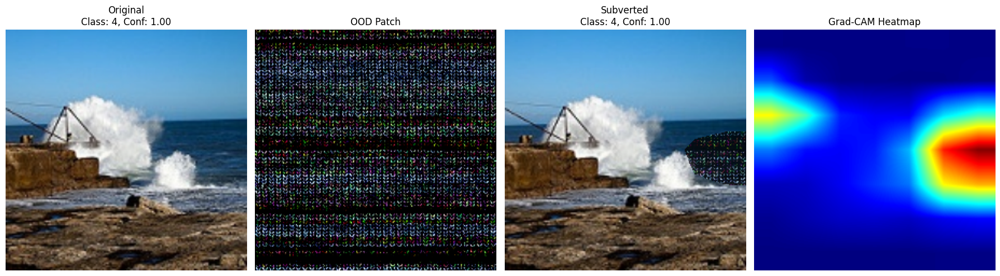

In [10]:
import torch
import numpy as np
import cv2
import matplotlib.pyplot as plt
from PIL import Image
from torchvision import transforms as T, models
from torchcam.methods import GradCAM
import torch.nn.functional as F
import lpips
import clip

# setting device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# loading CLIP model and its preprocessing
clipModel, clipPreprocess = clip.load("ViT-B/32", device=device)

# loading LPIPS model for measuring perceptual similarity
lpipsModel = lpips.LPIPS(net='alex').to(device)

# creating unnormalize transform to visualize original images
unnormalize = T.Normalize(
    mean=[-0.485 / 0.229, -0.456 / 0.224, -0.406 / 0.225],
    std=[1 / 0.229, 1 / 0.224, 1 / 0.225]
)

# transform for LPIPS (resize + tensor)
transformLpips = T.Compose([
    T.Resize((224, 224)),
    T.ToTensor(),
])

# transform for model input (normalize after tensor conversion)
transformModel = T.Compose([
    T.ToTensor(),
    T.Normalize(mean=[0.485, 0.456, 0.406],
                std=[0.229, 0.224, 0.225]),
])

# setting up Grad-CAM on the last feature layer of model
target_layer = modelENI.features[-1]
camExtractor = GradCAM(modelENI, target_layer)

# looping through images
for idx in range(50):
    imgTensor, label = intel_dataset[idx]
    inputTensor = imgTensor.unsqueeze(0).to(device)

    # converting tensor back to PIL image for visualization
    pilImage = T.ToPILImage()(unnormalize(imgTensor).clamp(0, 1)).convert('RGB')
    origImgNp = np.array(pilImage.resize((224, 224)))

    # running model and getting Grad-CAM
    output = modelENI(inputTensor)
    probs = F.softmax(output, dim=1)
    predClass = probs.argmax(dim=1).item()
    activationMap = camExtractor(predClass, output)[0].mean(dim=0).cpu().numpy()
    camUint8 = (cv2.resize(activationMap, (224, 224)) * 255).astype(np.uint8)
    camRgb = cv2.applyColorMap(camUint8, cv2.COLORMAP_JET)
    camRgb = cv2.cvtColor(camRgb, cv2.COLOR_BGR2RGB)
    camRgbPil = Image.fromarray(camRgb).convert('RGB')

    # getting CLIP features and LPIPS tensor
    imageClip = clipPreprocess(pilImage).unsqueeze(0).to(device)
    imageFeatures = clipModel.encode_image(imageClip).detach()
    origTensor = transformLpips(pilImage).unsqueeze(0).to(device)
    origLpipsTensor = (origTensor * 2) - 1  # LPIPS needs inputs in [-1, 1]

    # searching for the best OOD patch
    maxtotDist = -float("inf")
    bestPatch = None
    for batch, _ in oodLoader:
        batch = batch.to(device)
        for i in range(batch.size(0)):
            patch = batch[i].unsqueeze(0)
            patchResized = T.functional.resize(patch, [224, 224])
            patchLpips = (patchResized * 2) - 1
            textureDiff = lpipsModel(origLpipsTensor, patchLpips).item()

            patchpil = T.ToPILImage()(patchResized.squeeze(0).cpu())
            patchClip = clipPreprocess(patchpil).unsqueeze(0).to(device)
            patchFeatures = clipModel.encode_image(patchClip).detach()
            clipDist = 1 - F.cosine_similarity(imageFeatures, patchFeatures).item()

            totscore = textureDiff + clipDist
            if totscore > maxtotDist:
                maxtotDist = totscore
                bestPatch = patchResized.squeeze(0)

    if bestPatch is None:
        continue

    oodImgNp = (bestPatch.permute(1, 2, 0).cpu().numpy() * 255).clip(0, 255).astype(np.uint8)

    # creating mask for important regions from Grad-CAM heatmap
    orangeLow = np.array([180, 60, 0])
    orangeHigh = np.array([255, 180, 100])
    orangeMask = cv2.inRange(camRgb, orangeLow, orangeHigh)

    lowerRed = np.array([200, 0, 0])
    upperRed = np.array([255, 60, 60])
    brightRedMask = cv2.inRange(camRgb, lowerRed, upperRed)

    LowDred = np.array([120, 0, 0])
    HighDred = np.array([200, 40, 40])
    DredMask = cv2.inRange(camRgb, LowDred, HighDred)

    combMask = cv2.bitwise_or(orangeMask, brightRedMask)
    combMask = cv2.bitwise_or(combMask, DredMask)
    combMask_3ch = np.stack([combMask] * 3, axis=-1) // 255
    inv_mask = 1 - combMask_3ch

    # blending OOD patch into important regions
    alpha = 0.75
    blendedReg = (alpha * oodImgNp + (1 - alpha) * origImgNp).astype(np.uint8)
    subvertedImg = (blendedReg * combMask_3ch + origImgNp * inv_mask).astype(np.uint8)

    # running classification on original and subverted images
    blendedTensor = transformModel(Image.fromarray(subvertedImg)).unsqueeze(0).to(device)

    orgOutput = modelENI(inputTensor)
    orgProbs = F.softmax(orgOutput, dim=1)
    orgPred = orgProbs.argmax(dim=1).item()
    orgConf = orgProbs[0, orgPred].item()

    attackedOutput = modelENI(blendedTensor)
    attackedProbs = F.softmax(attackedOutput, dim=1)
    attackedPred = attackedProbs.argmax(dim=1).item()
    attackedConf = attackedProbs[0, attackedPred].item()

    # visualizing results for every 10th image
    if idx % 10 == 0:
        print(f"[{idx}] Original Class: {orgPred}, Conf: {orgConf:.4f} | Subverted Class: {attackedPred}, Conf: {attackedConf:.4f}")
        plt.figure(figsize=(18, 6))

        plt.subplot(1, 4, 1)
        plt.imshow(origImgNp)
        plt.title(f"Original\nClass: {orgPred}, Conf: {orgConf:.2f}")
        plt.axis("off")

        plt.subplot(1, 4, 2)
        plt.imshow(oodImgNp)
        plt.title("OOD Patch")
        plt.axis("off")

        plt.subplot(1, 4, 3)
        plt.imshow(subvertedImg)
        plt.title(f"Subverted\nClass: {attackedPred}, Conf: {attackedConf:.2f}")
        plt.axis("off")

        plt.subplot(1, 4, 4)
        plt.imshow(camRgbPil)
        plt.title("Grad-CAM Heatmap")
        plt.axis("off")

        plt.tight_layout()
        plt.show()

# Accuracy

Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /usr/local/lib/python3.11/dist-packages/lpips/weights/v0.1/alex.pth


/usr/local/lib/python3.11/dist-packages/lpips/lpips.py:107: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.load_state_dict(torch.load(model_path, map_location='cpu'), st

[0] True Label: 0, Original: 0, Conf: 1.0000 | Subverted: 0, Conf: 0.9999


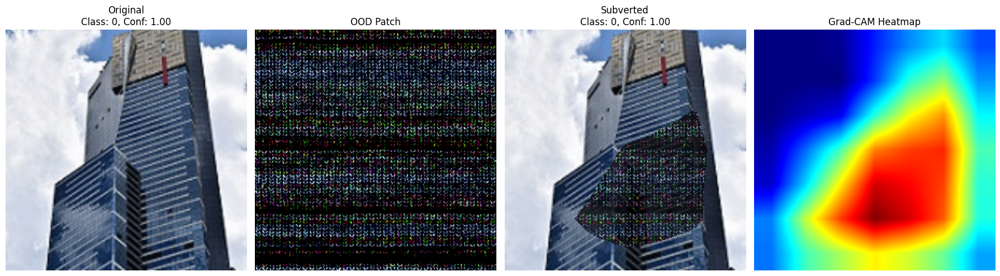

[10] True Label: 1, Original: 1, Conf: 0.9975 | Subverted: 5, Conf: 0.5231


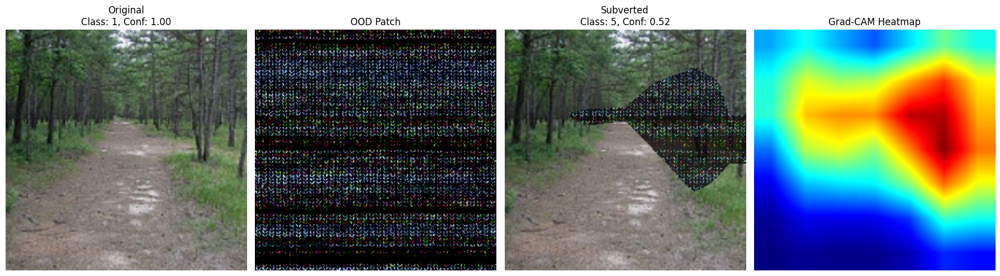

[20] True Label: 2, Original: 2, Conf: 1.0000 | Subverted: 0, Conf: 0.6985


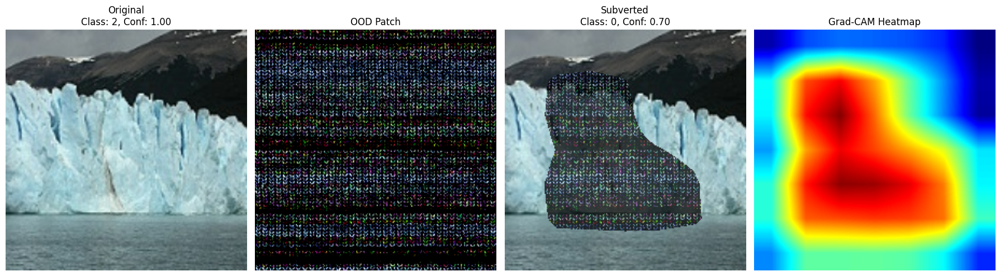

[30] True Label: 3, Original: 3, Conf: 0.9218 | Subverted: 4, Conf: 0.4652


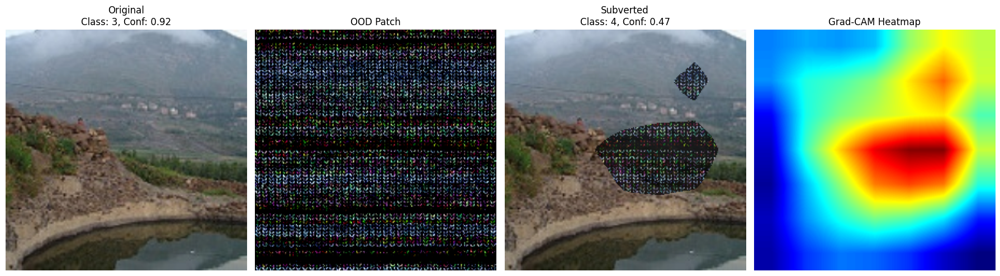

[40] True Label: 4, Original: 4, Conf: 0.9984 | Subverted: 4, Conf: 0.8981


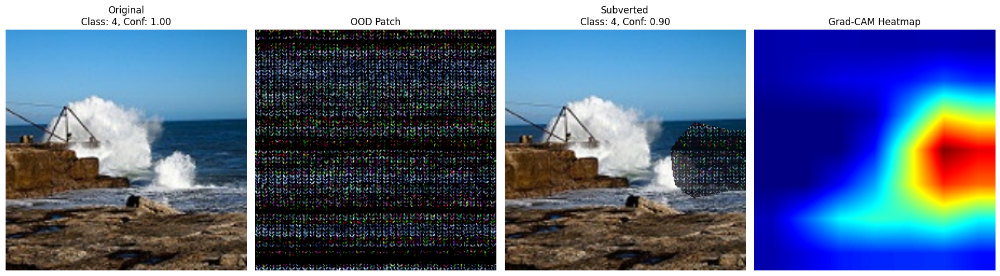


Final Results:
Original Accuracy: 94.00%
Subverted Accuracy: 76.00%


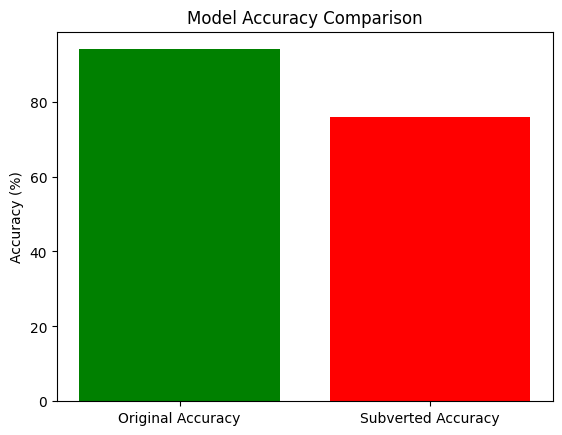

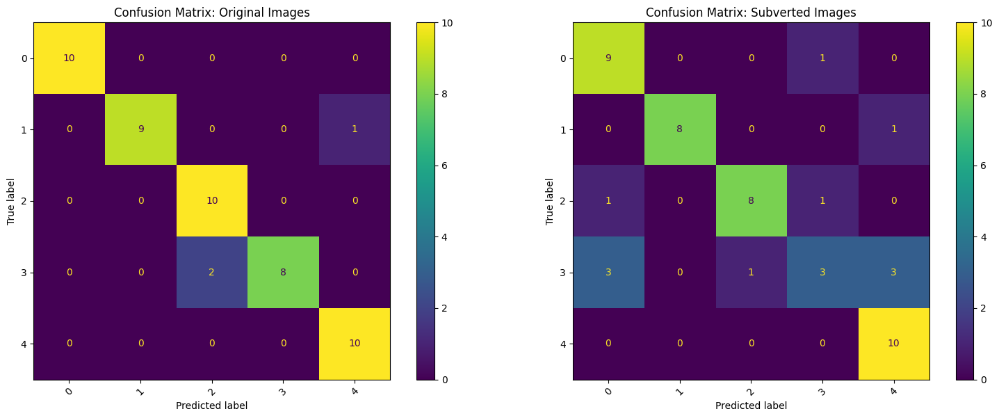

In [11]:
import torch
import numpy as np
import cv2
import matplotlib.pyplot as plt
from PIL import Image
from torchvision import transforms as T, models
from torchcam.methods import GradCAM
import torch.nn.functional as F
import lpips
import clip 
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

# setting device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# loading CLIP model and its preprocessing
clipModel, clipPreprocess = clip.load("ViT-B/32", device=device)

# loading LPIPS model for measuring perceptual similarity
lpipsModel = lpips.LPIPS(net='alex').to(device)

# creating unnormalize transform to visualize original images
unnormalize = T.Normalize(
    mean=[-0.485 / 0.229, -0.456 / 0.224, -0.406 / 0.225],
    std=[1 / 0.229, 1 / 0.224, 1 / 0.225]
)

# transform for LPIPS (resize + tensor)
transformLpips = T.Compose([
    T.Resize((224, 224)),
    T.ToTensor(),
])

# transform for model input (normalize after tensor conversion)
transformModel = T.Compose([
    T.ToTensor(),
    T.Normalize(mean=[0.485, 0.456, 0.406],
                std=[0.229, 0.224, 0.225]),
])

# setting up Grad-CAM on the last feature layer of model
target_layer = modelRNI.layer4[-1]
camExtractor = GradCAM(modelRNI, target_layer)

# Counting Accurate predictions
correct_clean = 0
correct_attacked = 0
total_samples = 0

# Storing labels and predictions
true_labels = []
preds_before_attack = []
preds_after_attack = []

# looping through images
for idx in range(50):  # Iterating through first 50 images
    imgTensor, label = intel_dataset[idx]
    inputTensor = imgTensor.unsqueeze(0).to(device)

    # Unnormalize
    pilImage = T.ToPILImage()(unnormalize(imgTensor).clamp(0, 1)).convert('RGB')
    origImgNp = np.array(pilImage.resize((224, 224)))

    # Grad-CAM
    output = modelRNI(inputTensor)
    probs = F.softmax(output, dim=1)
    predClass = probs.argmax(dim=1).item()
    activationMap = camExtractor(predClass, output)[0].mean(dim=0).cpu().numpy()
    camUint8 = (cv2.resize(activationMap, (224, 224)) * 255).astype(np.uint8)
    camRgb = cv2.applyColorMap(camUint8, cv2.COLORMAP_JET)
    camRgb = cv2.cvtColor(camRgb, cv2.COLOR_BGR2RGB)
    camRgbPil = Image.fromarray(camRgb).convert('RGB')

    # Feature vectors
    imageClip = clipPreprocess(pilImage).unsqueeze(0).to(device)
    imageFeatures = clipModel.encode_image(imageClip).detach()
    origTensor = transformLpips(pilImage).unsqueeze(0).to(device)
    origLpipsTensor = (origTensor * 2) - 1  # LPIPS expects [-1, 1]

    # OOD Patch Search
    maxtotDist = -float("inf")
    bestPatch = None
    for batch, _ in oodLoader:
        batch = batch.to(device)
        for i in range(batch.size(0)):
            patch = batch[i].unsqueeze(0)
            patchResized = T.functional.resize(patch, [224, 224])
            patchLpips = (patchResized * 2) - 1
            textureDiff = lpipsModel(origLpipsTensor, patchLpips).item()

            patchpil = T.ToPILImage()(patchResized.squeeze(0).cpu())
            patchClip = clipPreprocess(patchpil).unsqueeze(0).to(device)
            patchFeatures = clipModel.encode_image(patchClip).detach()
            clipDist = 1 - F.cosine_similarity(imageFeatures, patchFeatures).item()

            totscore = textureDiff + clipDist
            if totscore > maxtotDist:
                maxtotDist = totscore
                bestPatch = patchResized.squeeze(0)

    if bestPatch is None:
        continue

    oodImgNp = (bestPatch.permute(1, 2, 0).cpu().numpy() * 255).clip(0, 255).astype(np.uint8)

    # Causal Region Masking
    orangeLow = np.array([180, 60, 0])
    orangeHigh = np.array([255, 180, 100])
    orangeMask = cv2.inRange(camRgb, orangeLow, orangeHigh)

    lowerRed = np.array([200, 0, 0])
    upperRed = np.array([255, 60, 60])
    brightRedMask = cv2.inRange(camRgb, lowerRed, upperRed)

    LowDred = np.array([120, 0, 0])
    HighDred = np.array([200, 40, 40])
    DredMask = cv2.inRange(camRgb, LowDred, HighDred)

    combMask = cv2.bitwise_or(orangeMask, brightRedMask)
    combMask = cv2.bitwise_or(combMask, DredMask)
    combMask_3ch = np.stack([combMask] * 3, axis=-1) // 255
    inv_mask = 1 - combMask_3ch

    # Patch Blending
    alpha = 0.75
    blendedReg = (alpha * oodImgNp + (1 - alpha) * origImgNp).astype(np.uint8)
    subvertedImg = (blendedReg * combMask_3ch + origImgNp * inv_mask).astype(np.uint8)

    # Classification
    blendedTensor = transformModel(Image.fromarray(subvertedImg)).unsqueeze(0).to(device)

    orgOutput = modelRNI(inputTensor)
    orgProbs = F.softmax(orgOutput, dim=1)
    orgPred = orgProbs.argmax(dim=1).item()
    orgConf = orgProbs[0, orgPred].item()

    attackedOutput = modelRNI(blendedTensor)
    attackedProbs = F.softmax(attackedOutput, dim=1)
    attackedPred = attackedProbs.argmax(dim=1).item()
    attackedConf = attackedProbs[0, attackedPred].item()

    # Accuracy Update
    total_samples += 1

    if orgPred == label:
        correct_clean += 1

    if attackedPred == label:
        correct_attacked += 1

    # Storing true and predicted labels
    true_labels.append(label)
    preds_before_attack.append(orgPred)
    preds_after_attack.append(attackedPred)

    # Visualizing every 10th image
    if idx % 10 == 0:
        print(f"[{idx}] True Label: {label}, Original: {orgPred}, Conf: {orgConf:.4f} | Subverted: {attackedPred}, Conf: {attackedConf:.4f}")
        plt.figure(figsize=(18, 6))

        plt.subplot(1, 4, 1)
        plt.imshow(origImgNp)
        plt.title(f"Original\nClass: {orgPred}, Conf: {orgConf:.2f}")
        plt.axis("off")

        plt.subplot(1, 4, 2)
        plt.imshow(oodImgNp)
        plt.title("OOD Patch")
        plt.axis("off")

        plt.subplot(1, 4, 3)
        plt.imshow(subvertedImg)
        plt.title(f"Subverted\nClass: {attackedPred}, Conf: {attackedConf:.2f}")
        plt.axis("off")

        plt.subplot(1, 4, 4)
        plt.imshow(camRgbPil)
        plt.title("Grad-CAM Heatmap")
        plt.axis("off")

        plt.tight_layout()
        plt.show()

original_accuracy = correct_clean / total_samples * 100
subverted_accuracy = correct_attacked / total_samples * 100

print(f"\nFinal Results:")
print(f"Original Accuracy: {original_accuracy:.2f}%")
print(f"Subverted Accuracy: {subverted_accuracy:.2f}%")

# Visualizing the Accuracy Plot
plt.bar(['Original Accuracy', 'Subverted Accuracy'], [original_accuracy, subverted_accuracy], color=['green', 'red'])
plt.title('Model Accuracy Comparison')
plt.ylabel('Accuracy (%)')
plt.show()

# Plotting confusion matrices
fig, axes = plt.subplots(1, 2, figsize=(16, 6))

cm_orig = confusion_matrix(true_labels, preds_before_attack, labels=list(set(true_labels)))
disp_orig = ConfusionMatrixDisplay(confusion_matrix=cm_orig, display_labels=list(set(true_labels)))
disp_orig.plot(ax=axes[0], xticks_rotation=45)
axes[0].set_title("Confusion Matrix: Original Images")

cm_attacked = confusion_matrix(true_labels, preds_after_attack, labels=list(set(true_labels)))
disp_attacked = ConfusionMatrixDisplay(confusion_matrix=cm_attacked, display_labels=list(set(true_labels)))
disp_attacked.plot(ax=axes[1], xticks_rotation=45)
axes[1].set_title("Confusion Matrix: Subverted Images")

plt.tight_layout()
plt.show()


Setting up [LPIPS] perceptual loss: trunk [alex], v[0.1], spatial [off]


/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:208: UserWarning: The parameter 'pretrained' is deprecated since 0.13 and may be removed in the future, please use 'weights' instead.
  warnings.warn(
/usr/local/lib/python3.11/dist-packages/torchvision/models/_utils.py:223: UserWarning: Arguments other than a weight enum or `None` for 'weights' are deprecated since 0.13 and may be removed in the future. The current behavior is equivalent to passing `weights=AlexNet_Weights.IMAGENET1K_V1`. You can also use `weights=AlexNet_Weights.DEFAULT` to get the most up-to-date weights.
  warnings.warn(msg)


Loading model from: /usr/local/lib/python3.11/dist-packages/lpips/weights/v0.1/alex.pth


/usr/local/lib/python3.11/dist-packages/lpips/lpips.py:107: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  self.load_state_dict(torch.load(model_path, map_location='cpu'), st

[0] Original Class: 0, Conf: 0.9996 | Subverted Class: 0, Conf: 0.9992 | CFI: 0.0767


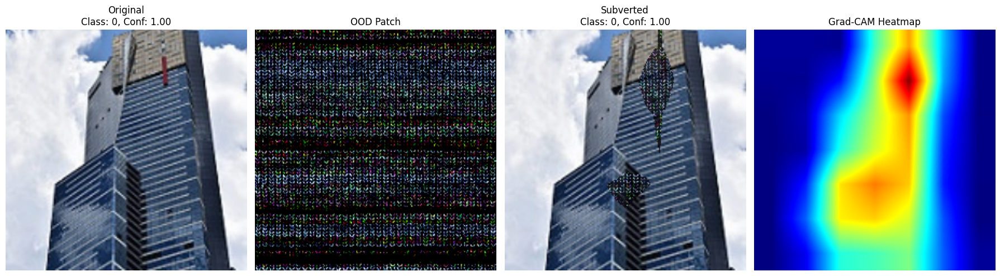

[10] Original Class: 1, Conf: 1.0000 | Subverted Class: 1, Conf: 1.0000 | CFI: 0.1000


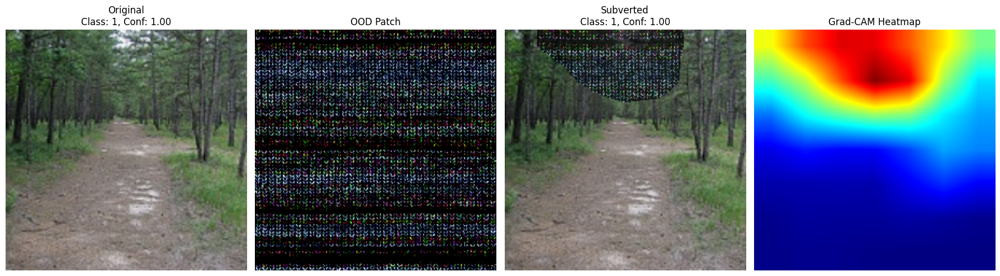

[20] Original Class: 2, Conf: 0.9999 | Subverted Class: 2, Conf: 0.9964 | CFI: 0.1020


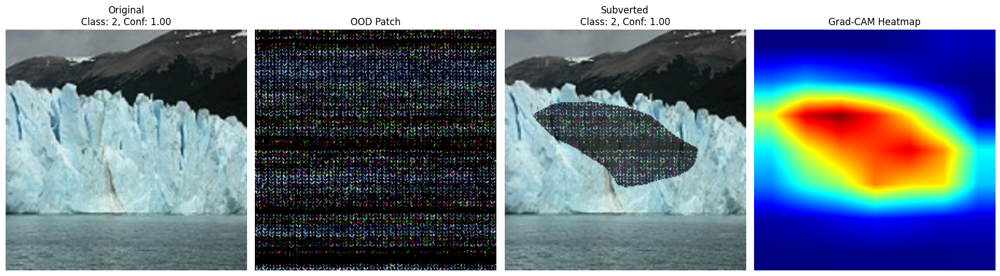

[30] Original Class: 3, Conf: 0.9990 | Subverted Class: 4, Conf: 0.4461 | CFI: 0.0496


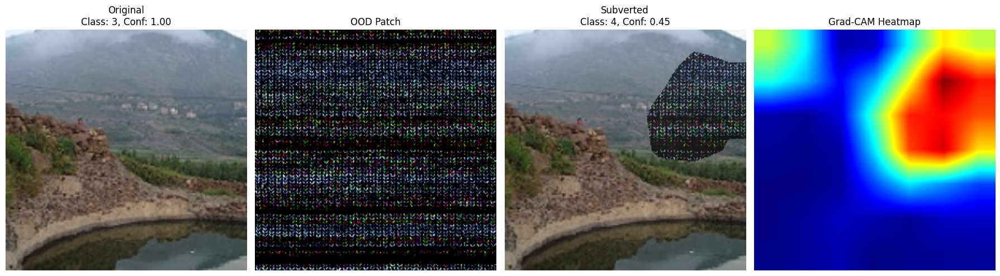

[40] Original Class: 4, Conf: 1.0000 | Subverted Class: 4, Conf: 1.0000 | CFI: 0.0519


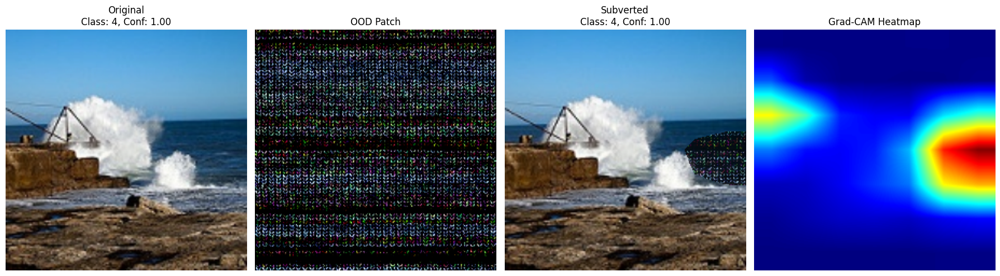


CFI Mean: 0.0776, CFI Std: 0.0282


In [12]:
import torch
import numpy as np
import cv2
import matplotlib.pyplot as plt
from PIL import Image
from torchvision import transforms as T, models
from torchcam.methods import GradCAM
import torch.nn.functional as F
import lpips
import clip

# setting device
device = torch.device("cuda" if torch.cuda.is_available() else "cpu")

# loading CLIP model and its preprocessing
clipModel, clipPreprocess = clip.load("ViT-B/32", device=device)

# loading LPIPS model for measuring perceptual similarity
lpipsModel = lpips.LPIPS(net='alex').to(device)

# creating unnormalize transform to visualize original images
unnormalize = T.Normalize(
    mean=[-0.485 / 0.229, -0.456 / 0.224, -0.406 / 0.225],
    std=[1 / 0.229, 1 / 0.224, 1 / 0.225]
)

# transform for LPIPS (resize + tensor)
transformLpips = T.Compose([
    T.Resize((224, 224)),
    T.ToTensor(),
])

# transform for model input (normalize after tensor conversion)
transformModel = T.Compose([
    T.ToTensor(),
    T.Normalize(mean=[0.485, 0.456, 0.406],
                std=[0.229, 0.224, 0.225]),
])

# setting up Grad-CAM on the last feature layer of model
target_layer = modelENI.features[-1]
camExtractor = GradCAM(modelENI, target_layer)

# store CFI scores
cfi_list = []

# looping through images
for idx in range(50):
    imgTensor, label = intel_dataset[idx]
    inputTensor = imgTensor.unsqueeze(0).to(device)

    # converting tensor back to PIL image for visualization
    pilImage = T.ToPILImage()(unnormalize(imgTensor).clamp(0, 1)).convert('RGB')
    origImgNp = np.array(pilImage.resize((224, 224)))

    # running model and getting Grad-CAM
    output = modelENI(inputTensor)
    probs = F.softmax(output, dim=1)
    predClass = probs.argmax(dim=1).item()
    activationMap = camExtractor(predClass, output)[0].mean(dim=0).cpu().numpy()
    camUint8 = (cv2.resize(activationMap, (224, 224)) * 255).astype(np.uint8)
    camRgb = cv2.applyColorMap(camUint8, cv2.COLORMAP_JET)
    camRgb = cv2.cvtColor(camRgb, cv2.COLOR_BGR2RGB)
    camRgbPil = Image.fromarray(camRgb).convert('RGB')

    # getting CLIP features and LPIPS tensor
    imageClip = clipPreprocess(pilImage).unsqueeze(0).to(device)
    imageFeatures = clipModel.encode_image(imageClip).detach()
    origTensor = transformLpips(pilImage).unsqueeze(0).to(device)
    origLpipsTensor = (origTensor * 2) - 1  # LPIPS needs inputs in [-1, 1]

    # searching for the best OOD patch
    maxtotDist = -float("inf")
    bestPatch = None
    for batch, _ in oodLoader:
        batch = batch.to(device)
        for i in range(batch.size(0)):
            patch = batch[i].unsqueeze(0)
            patchResized = T.functional.resize(patch, [224, 224])
            patchLpips = (patchResized * 2) - 1
            textureDiff = lpipsModel(origLpipsTensor, patchLpips).item()

            patchpil = T.ToPILImage()(patchResized.squeeze(0).cpu())
            patchClip = clipPreprocess(patchpil).unsqueeze(0).to(device)
            patchFeatures = clipModel.encode_image(patchClip).detach()
            clipDist = 1 - F.cosine_similarity(imageFeatures, patchFeatures).item()

            totscore = textureDiff + clipDist
            if totscore > maxtotDist:
                maxtotDist = totscore
                bestPatch = patchResized.squeeze(0)

    if bestPatch is None:
        continue

    oodImgNp = (bestPatch.permute(1, 2, 0).cpu().numpy() * 255).clip(0, 255).astype(np.uint8)

    # creating mask for important regions from Grad-CAM heatmap
    orangeLow = np.array([180, 60, 0])
    orangeHigh = np.array([255, 180, 100])
    orangeMask = cv2.inRange(camRgb, orangeLow, orangeHigh)

    lowerRed = np.array([200, 0, 0])
    upperRed = np.array([255, 60, 60])
    brightRedMask = cv2.inRange(camRgb, lowerRed, upperRed)

    LowDred = np.array([120, 0, 0])
    HighDred = np.array([200, 40, 40])
    DredMask = cv2.inRange(camRgb, LowDred, HighDred)

    combMask = cv2.bitwise_or(orangeMask, brightRedMask)
    combMask = cv2.bitwise_or(combMask, DredMask)
    combMask_3ch = np.stack([combMask] * 3, axis=-1) // 255
    inv_mask = 1 - combMask_3ch

    # blending OOD patch into important regions
    alpha = 0.75
    blendedReg = (alpha * oodImgNp + (1 - alpha) * origImgNp).astype(np.uint8)
    subvertedImg = (blendedReg * combMask_3ch + origImgNp * inv_mask).astype(np.uint8)

    # running classification on original and subverted images
    blendedTensor = transformModel(Image.fromarray(subvertedImg)).unsqueeze(0).to(device)

    orgOutput = modelENI(inputTensor)
    orgProbs = F.softmax(orgOutput, dim=1)
    orgPred = orgProbs.argmax(dim=1).item()
    orgConf = orgProbs[0, orgPred].item()

    attackedOutput = modelENI(blendedTensor)
    attackedProbs = F.softmax(attackedOutput, dim=1)
    attackedPred = attackedProbs.argmax(dim=1).item()
    attackedConf = attackedProbs[0, attackedPred].item()

    # CFI Calculation
    attacked_std = torch.std(attackedProbs).item()

    subvertedClip = clipPreprocess(Image.fromarray(subvertedImg)).unsqueeze(0).to(device)
    subvertedFeatures = clipModel.encode_image(subvertedClip).detach()
    clipSim = F.cosine_similarity(imageFeatures, subvertedFeatures).item()

    cfi = attacked_std * (1 - clipSim)
    cfi_list.append(cfi)

    # Printing info
    if idx % 10 == 0:
        print(f"[{idx}] Original Class: {orgPred}, Conf: {orgConf:.4f} | Subverted Class: {attackedPred}, Conf: {attackedConf:.4f} | CFI: {cfi:.4f}")

        plt.figure(figsize=(18, 6))
        plt.subplot(1, 4, 1)
        plt.imshow(origImgNp)
        plt.title(f"Original\nClass: {orgPred}, Conf: {orgConf:.2f}")
        plt.axis("off")

        plt.subplot(1, 4, 2)
        plt.imshow(oodImgNp)
        plt.title("OOD Patch")
        plt.axis("off")

        plt.subplot(1, 4, 3)
        plt.imshow(subvertedImg)
        plt.title(f"Subverted\nClass: {attackedPred}, Conf: {attackedConf:.2f}")
        plt.axis("off")

        plt.subplot(1, 4, 4)
        plt.imshow(camRgbPil)
        plt.title("Grad-CAM Heatmap")
        plt.axis("off")

        plt.tight_layout()
        plt.show()

# Final CFI Report
cfi_array = np.array(cfi_list)
print(f"\nCFI Mean: {cfi_array.mean():.4f}, CFI Std: {cfi_array.std():.4f}")